In [1]:
import pandas as pd
import os

## Ad Data

In [73]:
path = os.getcwd()
ad_df = pd.read_excel(f"{path}/ad_ranking_raw_data.xlsx")

In [3]:
ad_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40679 entries, 0 to 40678
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   p_date                    40679 non-null  int64         
 1   ad_id                     40679 non-null  int64         
 2   delivery_country          40679 non-null  object        
 3   queue_market              19524 non-null  object        
 4   punish_num                2393 non-null   float64       
 5   latest_punish_begin_date  40679 non-null  datetime64[ns]
 6   ad_revenue                29908 non-null  float64       
 7   avg_ad_revenue            40679 non-null  float64       
 8   start_time                34004 non-null  datetime64[ns]
 9   baseline_st               40679 non-null  float64       
 10  product_line              40679 non-null  object        
 11  task_type_en              40679 non-null  object        
dtypes: datetime64[ns](

### Data Cleaning

In [74]:
clean_df = ad_df
clean_df["punish_num"] = clean_df["punish_num"].fillna(0)

In [75]:
from datetime import datetime

# Get the current date and time
curr_datetime = datetime.now()

# Fill empty values in the 'date_column' with the current date and time
clean_df['start_time'].fillna(curr_datetime, inplace=True)

In [76]:
# Get new column of days after start time where account gets last punished
clean_df["punish_after_start_time"] = clean_df["latest_punish_begin_date"] - clean_df["start_time"]
clean_df["punish_after_start_time"] = clean_df["punish_after_start_time"].dt.days
clean_df.loc[clean_df["punish_after_start_time"] < 0, "punish_after_start_time"] = 0

In [77]:
# Avg ad revenue & ad revenue are somewhat linear -> used LR to map missing ad revenue values
import numpy as np
import math
from sklearn.linear_model import LinearRegression

cols_to_clean = ['ad_revenue']
temp_df = ad_df.dropna(subset = cols_to_clean)

# Square root transformation
temp_df.loc[temp_df["ad_revenue"] > 0, "ad_revenue"] = [math.sqrt(num) for num in temp_df.loc[temp_df["ad_revenue"] > 0, "ad_revenue"]]
temp_df.loc[temp_df["avg_ad_revenue"] > 0, "avg_ad_revenue"] = [math.sqrt(num) for num in temp_df.loc[temp_df["avg_ad_revenue"] > 0, "avg_ad_revenue"]]

# Sample data
X = np.array(temp_df["avg_ad_revenue"])  # Independent variable
Y = np.array(temp_df["ad_revenue"])  # Dependent variable

# Create a Linear Regression model
model = LinearRegression()

# Fit the model to the data
model.fit(X.reshape(-1, 1), Y)

# Obtain the coefficients
beta_0 = model.intercept_
beta_1 = model.coef_[0]

for index, row in clean_df.iterrows():

    sqrt_avg_rev = math.sqrt(clean_df.at[index, "avg_ad_revenue"])
    clean_df.at[index, "avg_ad_revenue"] = sqrt_avg_rev
    
    if pd.isna(row["ad_revenue"]):
        # Predict the missing ad_revenue value using the linear regression equation
        predicted_ad_revenue = beta_1 * sqrt_avg_rev + beta_0
        clean_df.at[index, "ad_revenue"] = predicted_ad_revenue
    else:
        sqrt_ad_rev = math.sqrt(clean_df.at[index, "ad_revenue"])
        clean_df.at[index, "ad_revenue"] = sqrt_ad_rev

clean_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40679 entries, 0 to 40678
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   p_date                    40679 non-null  int64         
 1   ad_id                     40679 non-null  int64         
 2   delivery_country          40679 non-null  object        
 3   queue_market              19524 non-null  object        
 4   punish_num                40679 non-null  float64       
 5   latest_punish_begin_date  40679 non-null  datetime64[ns]
 6   ad_revenue                40679 non-null  float64       
 7   avg_ad_revenue            40679 non-null  float64       
 8   start_time                40679 non-null  datetime64[ns]
 9   baseline_st               40679 non-null  float64       
 10  product_line              40679 non-null  object        
 11  task_type_en              40679 non-null  object        
 12  punish_after_start

### Robust Scaling & Min-Max Scaling

In [8]:
num_cols = ["punish_num", "ad_revenue",	"avg_ad_revenue", "baseline_st", "punish_after_start_time"]

In [9]:
import numpy as np
from sklearn.preprocessing import RobustScaler

scaler = RobustScaler()

scaled_array = scaler.fit_transform(clean_df[num_cols])

In [10]:
scaled_df = pd.DataFrame(data=scaled_array, columns=num_cols)

In [11]:
min_ad_revenue = scaled_df["ad_revenue"].min()
if min_ad_revenue < 0:
    scaled_df["ad_revenue"] += -min_ad_revenue

min_avg_ad = scaled_df["avg_ad_revenue"].min()
if min_avg_ad < 0:
    scaled_df["avg_ad_revenue"] += -min_avg_ad

min_baseline = scaled_df["baseline_st"].min()
if min_baseline < 0:
    scaled_df["baseline_st"] += -min_baseline

scaled_df

,punish_num,ad_revenue,avg_ad_revenue,baseline_st,punish_after_start_time
0,1.0,25.369276,35.300149,1.000000,272.0
1,1.0,15.742674,16.626245,0.911290,111.0
2,2.0,0.466520,1.180744,1.048387,374.0
3,2.0,1.238282,1.180744,0.838710,374.0
4,2.0,0.437313,1.180744,0.838710,374.0
...,...,...,...,...,...
40674,0.0,0.191905,0.000000,0.000000,0.0
40675,0.0,0.191905,0.000000,0.000000,0.0
40676,0.0,0.191905,0.000000,0.000000,0.0
40677,0.0,0.191905,0.000000,0.000000,0.0


In [12]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaled_array_df_2 = scaler.fit_transform(scaled_df)

scaled_df_2 = pd.DataFrame(data=scaled_array_df_2, columns=num_cols)
scaled_df_2

,punish_num,ad_revenue,avg_ad_revenue,baseline_st,punish_after_start_time
0,0.0625,0.435172,0.528863,0.175887,0.542914
1,0.0625,0.270042,0.249093,0.160284,0.221557
2,0.1250,0.008002,0.017690,0.184397,0.746507
3,0.1250,0.021241,0.017690,0.147518,0.746507
4,0.1250,0.007501,0.017690,0.147518,0.746507
...,...,...,...,...,...
40674,0.0000,0.003292,0.000000,0.000000,0.000000
40675,0.0000,0.003292,0.000000,0.000000,0.000000
40676,0.0000,0.003292,0.000000,0.000000,0.000000
40677,0.0000,0.003292,0.000000,0.000000,0.000000


### Data Viz

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

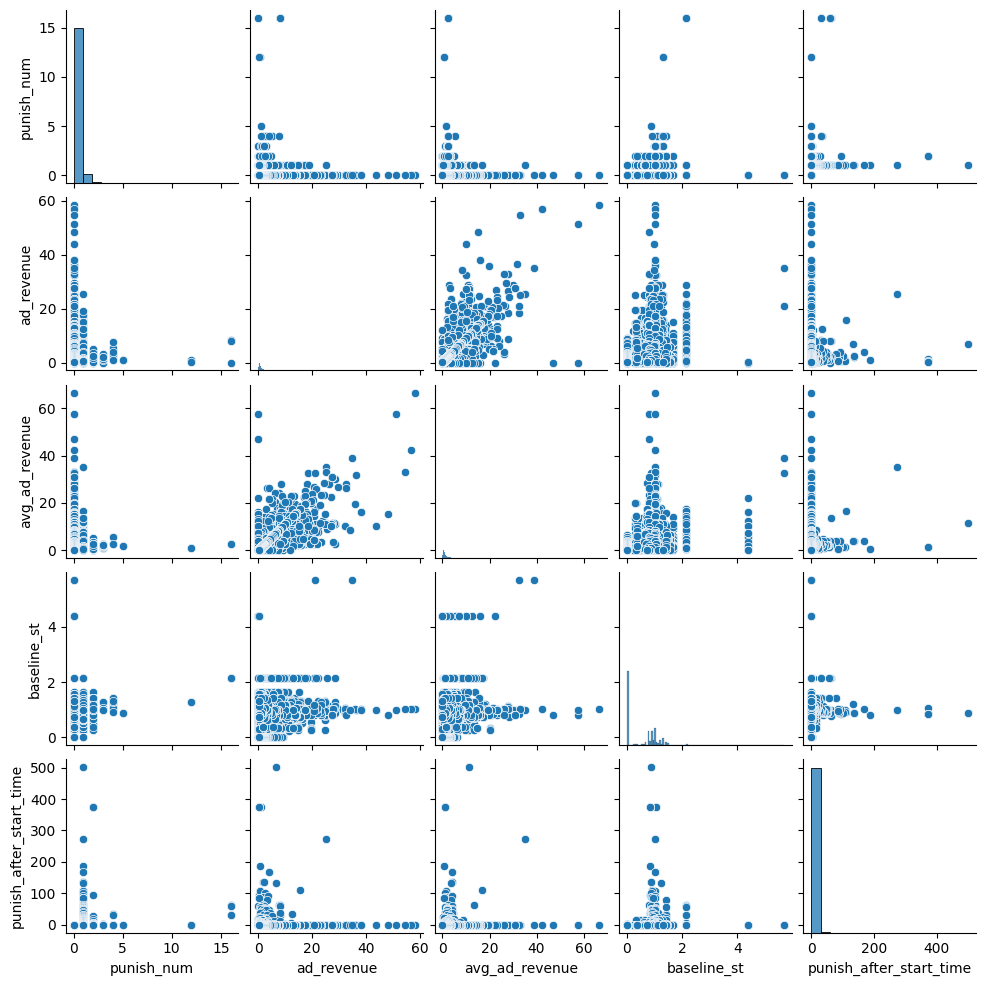

In [14]:
sns.pairplot(scaled_df, height=2)
plt.show() 

### Gurobipy 

In [15]:
from collections import defaultdict
import gurobipy as grb
from gurobipy import GRB

In [16]:
model = grb.Model("ads_optimisation")

Set parameter Username
Academic license - for non-commercial use only - expires 2024-09-06


In [17]:
w1 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="baseline")
w2 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="avg_ad_rev")
w3 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="punishNum")
w4 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="punish_duration")
w5 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="ad_rev")
w6 = model.addVar(lb=0.0001, ub=10, vtype=GRB.CONTINUOUS, name="placeholder")

<Axes: >

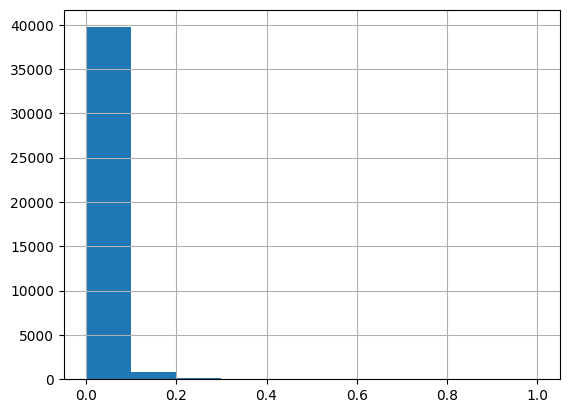

In [59]:
scaled_df_2['avg_ad_revenue'].hist()

In [48]:
punish_dur = scaled_df_2['punish_after_start_time'].tolist()
baseline = scaled_df_2['baseline_st'].tolist()
punish_num = scaled_df_2['punish_num'].tolist()
avg_ad_rev = scaled_df_2['avg_ad_revenue'].tolist()
ad_rev = scaled_df_2['ad_revenue'].tolist()

baseline_scores = []
avg_ad_scores = []
punishNum_scores = []
punish_duration = []
rev_scores = []
final_score = []

for i in range(len(baseline)):

    model.setObjective(
        expr = baseline[i] * w1 + punish_dur[i] * w2 + w3 * punish_num[i] + w4 * avg_ad_rev[i] + w5 * ad_rev[i],
        sense = GRB.MAXIMIZE
    )

    model.addConstr(w1 >= w2 + 0.0001, name="w1_gt_w2")
    model.addConstr(w2 >= w3 + 0.0001, name="w2_gt_w3")
    model.addConstr(w3 >= w4 + 0.0001, name="w3_gt_w4")
    model.addConstr(w4 >= w5 + 0.0001, name="w4_gt_w5")
    model.addConstr(w5 >= w6, name="w5_gt_0")

    # Add upper and lower bound constraints for each variable
    model.addConstr(baseline[i] * w1 + punish_dur[i] * w2 + w3 * punish_num[i] + w4 * avg_ad_rev[i] + w5 * ad_rev[i] <= 1, name=f"upper_bound_{i}")
    model.addConstr(baseline[i] * w1 + punish_dur[i] * w2 + w3 * punish_num[i] + w4 * avg_ad_rev[i] + w5 * ad_rev[i] >= 0, name=f"lower_bound_{i}")

    model.update()
    model.optimize()

    # Check if an optimal solution was found
    if model.status == GRB.OPTIMAL:
        # Retrieve and print the optimal values of decision variables
        optimal_w1 = w1.x
        optimal_w2 = w2.x
        optimal_w3 = w3.x
        optimal_w4 = w4.x
        optimal_w5 = w5.x

        # Retrieve and print the optimal objective value
        optimal_objective_value = model.objVal

        baseline_scores.append(optimal_w1)
        avg_ad_scores.append(optimal_w2)
        punishNum_scores.append(optimal_w3)
        punish_duration.append(optimal_w4)
        rev_scores.append(optimal_w5)
        final_score.append(optimal_objective_value)

        print(i)
    else:
        print("No optimal solution found.")

Gurobi Optimizer version 10.0.2 build v10.0.2rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 707 rows, 6 columns and 1928 nonzeros
Coefficient statistics:
  Matrix range     [5e-03, 1e+00]
  Objective range  [6e-02, 5e-01]
  Bounds range     [1e-04, 1e+03]
  RHS range        [1e-04, 1e+00]
Iteration    Objective       Primal Inf.    Dual Inf.      Time
       0    1.4609088e+31   3.034290e+33   1.460909e+01      0s
       8    1.0000000e+00   0.000000e+00   0.000000e+00      0s

Solved in 8 iterations and 0.00 seconds (0.00 work units)
Optimal objective  1.000000000e+00
0
Gurobi Optimizer version 10.0.2 build v10.0.2rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 714 rows, 6 columns and 1948 nonzeros
Coefficient statistics:
  Matrix range     [5e-03, 1e+00]
  Objective range  [6e-02, 3e-01]
  Bounds ran

In [49]:
checker = pd.DataFrame()

checker['punish_num'] = punishNum_scores
checker['ad_rev'] = rev_scores
checker['avg_rev'] = avg_ad_scores
checker['baseline'] = baseline_scores
checker['punish_duration'] = punish_duration
checker['final'] = final_score

checker

,punish_num,ad_rev,avg_rev,baseline,punish_duration,final
0,0.465225,0.465025,0.726978,0.727078,0.465125,1.000000
1,0.425035,0.424835,0.685308,1.090262,0.424935,0.573723
2,0.000300,0.000100,0.628023,2.427767,0.000200,0.916538
3,0.000300,0.000100,0.628023,2.427767,0.000200,0.827005
4,0.000300,0.000100,0.628023,2.427767,0.000200,0.827004
...,...,...,...,...,...,...
40674,0.457770,0.457570,0.457870,0.457970,0.457670,0.001506
40675,0.457770,0.457570,0.457870,0.457970,0.457670,0.001506
40676,0.457770,0.457570,0.457870,0.457970,0.457670,0.001506
40677,0.457770,0.457570,0.457870,0.457970,0.457670,0.001506


In [50]:
clean_df["final_score"] = checker["final"]

<Axes: >

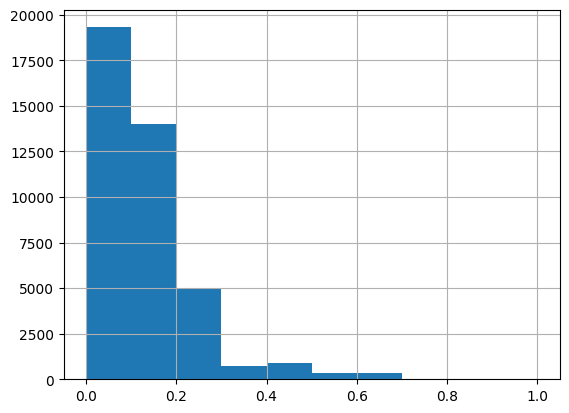

In [52]:
# Raw -> no sqaure rooting
clean_df["final_score"].hist()

<Axes: >

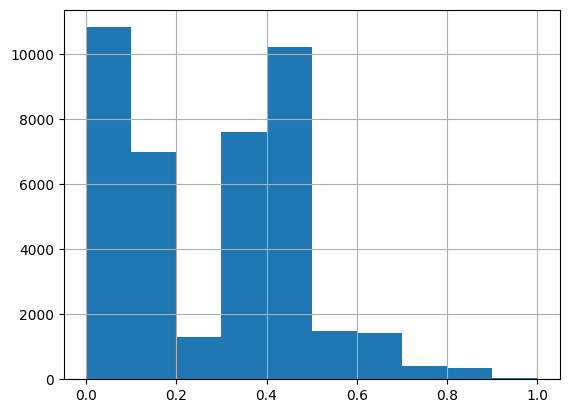

In [69]:
# After square-root transformation
clean_df["final_score"] = [math.sqrt(x) for x in checker["final"]]
clean_df["final_score"].hist()

In [70]:
clean_df.to_csv('ads_data_transformed.csv', index=False)

## Moderator Data

In [22]:
moderators_df = pd.read_excel(f"{path}/new_ad_ranking.xlsx")
moderators_df.columns = ['moderator', 'market', 'Productivity', 'Utilisation %', 'handling time', 'accuracy']
moderators_df.rename(columns={'moderator': 'moderator', 'market': 'market', "Productivity": "productivity", "Utilisation %": "utilisation", "handling time": "handling_time", " accuracy ":"accuracy"}, inplace=True)

In [23]:
def remove_empty(x):
    if isinstance(x, str):  # Use isinstance to check if x is of type str
        return 0
    return x

moderators_df["accuracy"] = moderators_df["accuracy"].apply(remove_empty)

moderators_df["productivity"] = moderators_df["productivity"].fillna(0)
moderators_df["utilisation"] = moderators_df["utilisation"].fillna(0)

moderators_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1414 entries, 0 to 1413
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   moderator      1414 non-null   int64  
 1   market         1414 non-null   object 
 2   productivity   1414 non-null   float64
 3   utilisation    1414 non-null   float64
 4   handling_time  1414 non-null   int64  
 5   accuracy       1414 non-null   float64
dtypes: float64(3), int64(2), object(1)
memory usage: 66.4+ KB


In [24]:
num_cols_m = ["productivity", "utilisation", "handling_time", "accuracy"]

# Robust Scaling

scaler = RobustScaler()

scaled_array_2 = scaler.fit_transform(moderators_df[num_cols_m])
scaled_df_m_2 = pd.DataFrame(data=scaled_array_2, columns=num_cols_m)

for col in num_cols_m:
    min_val = scaled_df_m_2[col].min()
    
    if min_val < 0:
        scaled_df_m_2[col] += -min_val

scaled_df_m_2

,productivity,utilisation,handling_time,accuracy
0,2.127917,2.693429,1.578596,1.700680
1,0.530877,0.000000,0.598776,1.700680
2,0.043601,4.262383,0.006678,2.040816
3,0.802577,1.993242,10.568137,2.149660
4,0.000000,0.000000,0.000000,2.265306
...,...,...,...,...
1409,0.393359,0.955700,0.290167,0.000000
1410,0.826167,2.695681,1.745127,0.000000
1411,0.656097,2.802140,1.773330,0.000000
1412,0.000000,0.000000,0.000000,0.000000


In [25]:
# Min-Max Scaling

scaler = MinMaxScaler()
scaled_array_df_m = scaler.fit_transform(scaled_df_m_2)

scaled_df_m = pd.DataFrame(data=scaled_array_df_m, columns=num_cols_m)
scaled_df_m["accuracy"] = moderators_df["accuracy"]

scaled_df_m

,productivity,utilisation,handling_time,accuracy
0,0.379490,0.556467,0.008511,0.250
1,0.094676,0.000000,0.003228,0.250
2,0.007776,0.880616,0.000036,0.300
3,0.143131,0.411807,0.056978,0.316
4,0.000000,0.000000,0.000000,0.333
...,...,...,...,...
1409,0.070151,0.197449,0.001564,0.000
1410,0.147338,0.556933,0.009409,0.000
1411,0.117008,0.578927,0.009561,0.000
1412,0.000000,0.000000,0.000000,0.000


In [26]:
scaled_df_m["accuracy"] = moderators_df["accuracy"]
scaled_df_m

,productivity,utilisation,handling_time,accuracy
0,0.379490,0.556467,0.008511,0.250
1,0.094676,0.000000,0.003228,0.250
2,0.007776,0.880616,0.000036,0.300
3,0.143131,0.411807,0.056978,0.316
4,0.000000,0.000000,0.000000,0.333
...,...,...,...,...
1409,0.070151,0.197449,0.001564,0.000
1410,0.147338,0.556933,0.009409,0.000
1411,0.117008,0.578927,0.009561,0.000
1412,0.000000,0.000000,0.000000,0.000


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

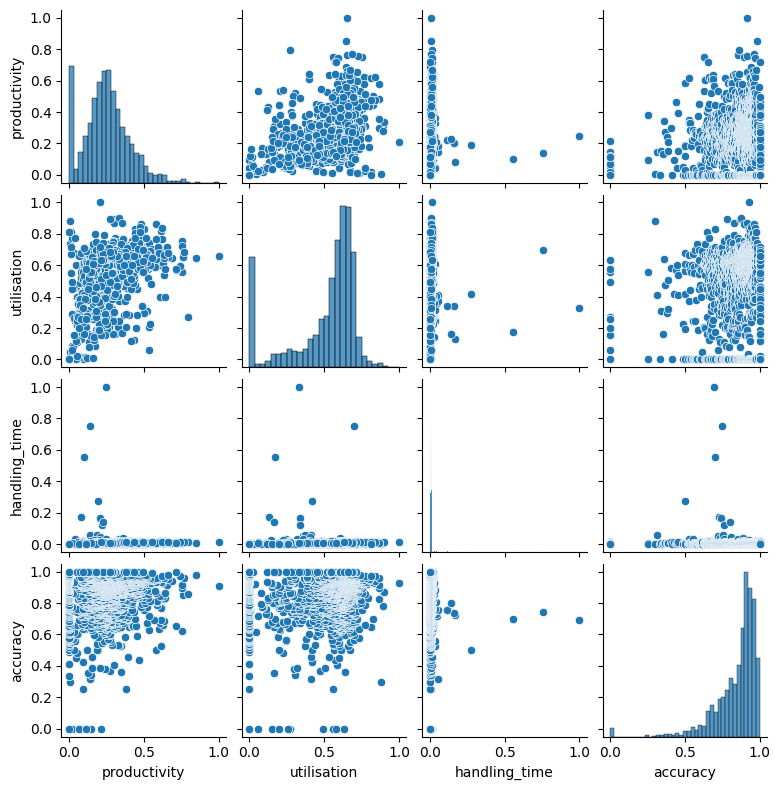

In [27]:
# Data viz
sns.pairplot(scaled_df_m, height=2)
plt.show() 

<Axes: >

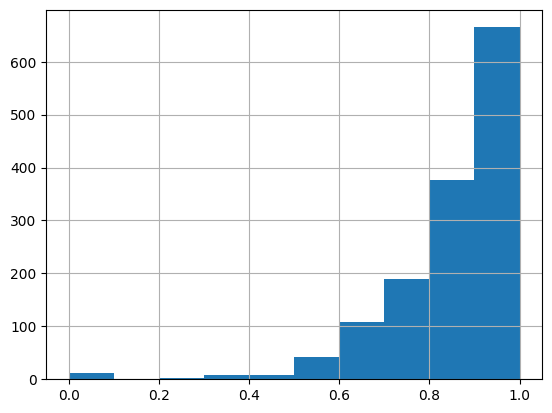

In [28]:
moderators_df["accuracy"].hist()

### Gurobipy Optimisation

In [29]:
temp_df = moderators_df[num_cols_m]

In [30]:
model_m = grb.Model("ads_optimisation")

w1_m = model_m.addVar(lb=0, ub=10000, vtype=GRB.CONTINUOUS, name="w1")
w2_m = model_m.addVar(lb=0, ub=10000, vtype=GRB.CONTINUOUS, name="w2")
w3_m = model_m.addVar(lb=0, ub=10000, vtype=GRB.CONTINUOUS, name="w3")
w4_m = model_m.addVar(lb=0, ub=10000, vtype=GRB.CONTINUOUS, name="w4")
w5_m = model_m.addVar(lb=0.0001, ub=10, vtype=GRB.CONTINUOUS, name="placeholder")

In [43]:
accuracy = scaled_df_m['accuracy'].tolist()
utilisation = scaled_df_m['utilisation'].tolist()
productivity = scaled_df_m['productivity'].tolist()
handling_time = scaled_df_m['handling_time'].tolist()

prod_scores = []
util_scores = []
handle_time_scores = []
accuracy_scores = []
final_score = []

for i in range(len(accuracy)):

    model_m.setObjective(
        expr = w1_m * accuracy[i] + utilisation[i] * w2_m + w3_m * productivity[i] + handling_time[i] * w4_m,
        sense = GRB.MAXIMIZE
    )

    model_m.addConstr(w1_m >= w2_m, name="w1_gt_w2")
    model_m.addConstr(w2_m >= w3_m, name="w2_gt_w3")
    model_m.addConstr(w3_m >= w4_m + 0.0001, name="w3_gt_w4")
    model_m.addConstr(w4_m >= w5_m, name="w4_gt_w5")

    # Add upper and lower bound constraints for each variable
    model_m.addConstr(w1_m * accuracy[i] + utilisation[i] * w2_m + w3_m * productivity[i] + handling_time[i] * w4_m <= 1, name=f"upper_bound_{i}")
    model_m.addConstr(w1_m * accuracy[i] + utilisation[i] * w2_m + w3_m * productivity[i] + handling_time[i] * w4_m >= 0, name=f"lower_bound_{i}")

    model_m.update()
    model_m.optimize()

    # Check if an optimal solution was found
    if model_m.status == GRB.OPTIMAL:
        # Retrieve and print the optimal values of decision variables
        optimal_w1 = w1_m.x
        optimal_w2 = w2_m.x
        optimal_w3 = w3_m.x
        optimal_w4 = w4_m.x

        # Retrieve and print the optimal objective value
        optimal_objective_value = model_m.objVal

        accuracy_scores.append(optimal_w1)
        util_scores.append(optimal_w2)
        prod_scores.append(optimal_w3)
        handle_time_scores.append(optimal_w4)
        final_score.append(optimal_objective_value)

        print(i)
    else:
        print("No optimal solution found.")

Gurobi Optimizer version 10.0.2 build v10.0.2rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 15210 rows, 5 columns and 39060 nonzeros
Coefficient statistics:
  Matrix range     [8e-06, 1e+00]
  Objective range  [9e-03, 6e-01]
  Bounds range     [1e-04, 1e+04]
  RHS range        [1e-04, 1e+00]
Iteration    Objective       Primal Inf.    Dual Inf.      Time
       0    8.9804779e+30   3.533676e+34   8.980478e+00      0s
      10    4.7606409e-01   0.000000e+00   0.000000e+00      0s

Solved in 10 iterations and 0.01 seconds (0.01 work units)
Optimal objective  4.760640904e-01
0
Gurobi Optimizer version 10.0.2 build v10.0.2rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 15216 rows, 5 columns and 39074 nonzeros
Coefficient statistics:
  Matrix range     [8e-06, 1e+00]
  Objective range  [3e-03, 2e-01]
  Bou

In [44]:
checker = pd.DataFrame()

checker['productivity'] = prod_scores
checker['utilisation'] = util_scores
checker['handling_time'] = handle_time_scores
checker['accuracy'] = accuracy_scores
checker['final'] = final_score

checker.head(20)

,productivity,utilisation,handling_time,accuracy,final
0,0.292680,0.449497,0.292580,0.449497,0.476064
1,0.000200,0.000200,0.000100,0.999741,0.249954
2,0.000200,0.518113,0.000100,0.518113,0.611694
3,0.143923,0.501719,0.143823,0.501719,0.393950
4,0.000200,0.000200,0.000100,0.999741,0.332914
5,0.000200,0.216197,0.000100,0.842753,0.353016
6,0.000200,0.000200,0.000100,0.999741,0.352967
7,0.292680,0.449497,0.292580,0.449497,0.554806
8,0.144351,0.502617,0.000100,0.502617,0.461188
9,0.064975,0.120818,0.000100,0.883716,0.387522


<Axes: >

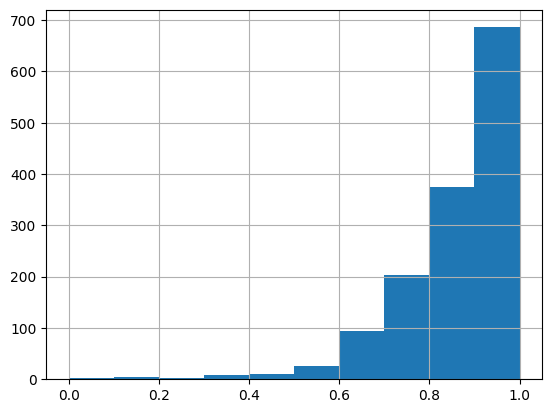

In [45]:
checker["final"].hist()

In [47]:
moderators_df["final_score"] = checker['final']
moderators_df.to_csv('moderators_data.csv', index=False)

## Mapping Ads to Moderators

In [78]:
# filling NaN values in queue market with the devlivery mkt instead
reclean_queueMkt = []

df = clean_df 

for i in range(len(df['queue_market'])):
    qMkt = df['queue_market'].iloc[i]
    
    if df['queue_market'].iloc[i] is None:
        reclean_queueMkt.append([df['delivery_country'].iloc[i]])

    elif df['queue_market'].iloc[i] == "Others":
        reclean_queueMkt.append(["Other"])
    
    elif df['queue_market'].iloc[i] == "Other":
        reclean_queueMkt.append(["Other"])
    
    elif type(df['queue_market'].iloc[i]) is float:
        reclean_queueMkt.append([df['delivery_country'].iloc[i]])
        
    elif df['queue_market'].iloc[i] == '':
        reclean_queueMkt.append([df['delivery_country'].iloc[i]])

    # creates list 
    elif len(df['queue_market'].iloc[i]) > 2:
        
        if 'USCA' in qMkt:
            x = ['US','CA']
            reclean_queueMkt.append(x)
        
        elif  'US&CA' in qMkt:
            x = ['US','CA']
            reclean_queueMkt.append(x)

        elif 'KW/AE/SA' in qMkt:
            x = ['KW','AE','SA']
            reclean_queueMkt.append(x)

        elif 'MENA' in qMkt:
            reclean_queueMkt.append([df['delivery_country'].iloc[i]])
        
        else:
            x = [qMkt]
            reclean_queueMkt.append(x)

    else:
        x = [qMkt]
        reclean_queueMkt.append(x)
            
df['queue_market'] = reclean_queueMkt
df

,p_date,ad_id,delivery_country,queue_market,punish_num,latest_punish_begin_date,ad_revenue,avg_ad_revenue,start_time,baseline_st,product_line,task_type_en,punish_after_start_time
0,20230807,1747578422390810,US,"[US, CA]",1.0,2023-07-24,71.639165,69.247744,2022-10-24 14:36:00.000000,1.78,Auction Ads,auction_relation,272
1,20230807,1758543228094480,SA,[SA],1.0,2023-06-14,44.455033,32.615441,2023-02-22 15:50:00.000000,1.67,RIE,Ad Group Recall (Merged),111
2,20230807,1738303151826990,AU,[AU],2.0,2023-07-24,1.317384,2.316247,2022-07-14 05:00:00.000000,1.84,Auction Ads,auction_relation,374
3,20230807,1738303920938010,NZ,[NZ],2.0,2023-07-24,3.496730,2.316247,2022-07-14 05:16:00.000000,1.58,Auction Ads,auction_relation,374
4,20230807,1738304016410620,NZ,[NZ],2.0,2023-07-24,1.234909,2.316247,2022-07-14 05:17:00.000000,1.58,Auction Ads,auction_relation,374
...,...,...,...,...,...,...,...,...,...,...,...,...,...
40674,20230807,1773472206047230,VN,[VN],0.0,2000-01-01,0.541911,0.000000,2023-09-08 13:55:42.386972,0.54,Non-Auction Ads,Promote,0
40675,20230807,1773607712030720,BR,[BR],0.0,2000-01-01,0.541911,0.000000,2023-09-08 13:55:42.386972,0.54,Non-Auction Ads,Promote,0
40676,20230807,1773589699308540,BE,[BE],0.0,2000-01-01,0.541911,0.000000,2023-09-08 13:55:42.386972,0.54,Non-Auction Ads,Promote,0
40677,20230807,1773530511220730,TR,[TR],0.0,2000-01-01,0.541911,0.000000,2023-09-08 13:55:42.386972,0.54,Non-Auction Ads,Promote,0


In [80]:
df['queue_market'].value_counts()

queue_market
[SA]            3667
[ID]            3585
[TH]            3530
[VN]            3502
[Other]         2802
[BR]            2768
[US, CA]        2572
[US]            1941
[MY]            1668
[TR]            1502
[GB]            1141
[PH]            1058
[KR]             772
[DE]             655
[FR]             653
[IT]             615
[JP]             611
[AE]             598
[AU]             539
[PL]             491
[ES]             463
[IL]             448
[EG]             393
[KH]             389
[GR]             386
[TW]             353
[RO]             321
[IE]             228
[KW]             228
[PK]             223
[NL]             207
[DK]             197
[PT]             194
[SE]             188
[CA]             187
[NZ]             183
[BE]             139
[SG]             134
[MX]             131
[CH]             121
[AT]             121
[CZ]             100
[QA]              92
[KZ]              89
[HU]              84
[PE]              82
[ZA]              75
